## First part

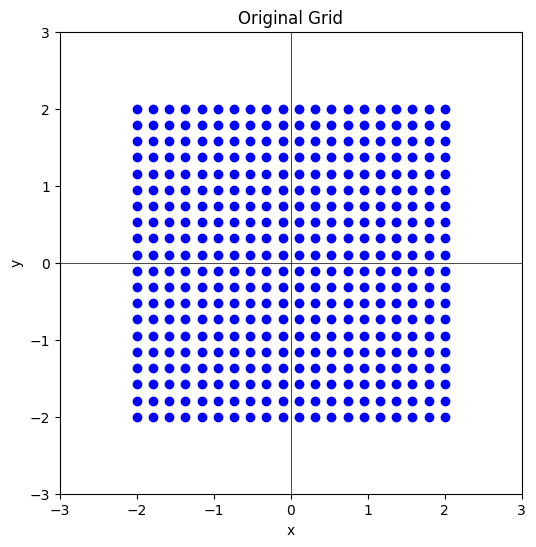

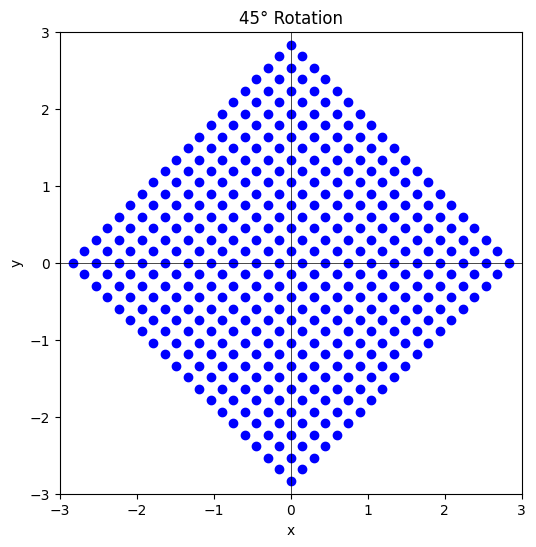

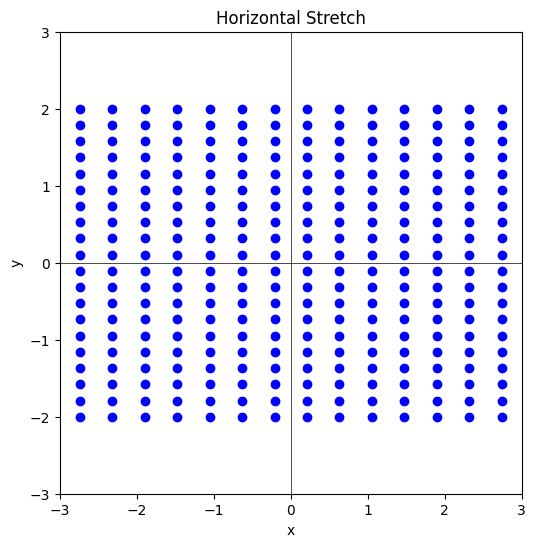

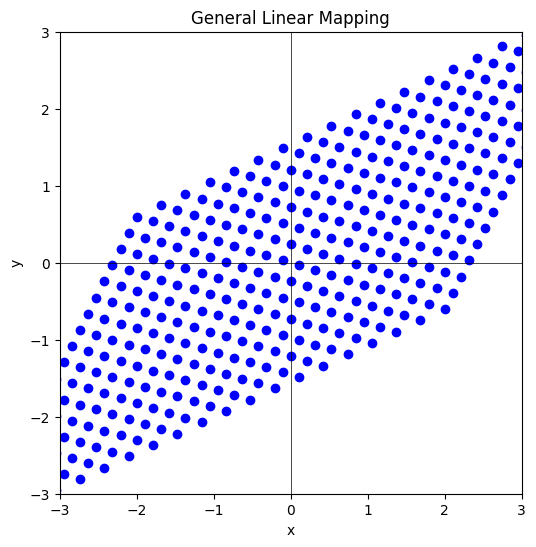

In [4]:
import numpy as np
import matplotlib.pyplot as plt

def generate_grid_points(n_points, grid_range):
    """
    Generate n_points 2D points arranged in a square grid.
    
    Parameters
    ----------
    n_points : int
        Total number of points (should be a perfect square, e.g. 400 = 20x20).
    grid_range : tuple of two floats
        The minimum and maximum value for both x and y coordinates.
    
    Returns
    -------
    points : numpy.ndarray
        A 2 x n_points array where each column is a point (x, y).
    """
    side = int(np.sqrt(n_points))
    coords = np.linspace(grid_range[0], grid_range[1], side)
    X, Y = np.meshgrid(coords, coords)
    points = np.vstack((X.flatten(), Y.flatten()))
    return points

def plot_points(points, title, grid_range):
    """
    Plot 2D points.
    
    Parameters
    ----------
    points : numpy.ndarray
        A 2 x n array of points to plot.
    title : str
        The title of the plot.
    grid_range : tuple of two floats
        The range used to generate the grid. The plotting limits will be this range extended by 1.
    """
    # Extend the grid_range by 1 for plotting limits
    x_lim = (grid_range[0] - 1, grid_range[1] + 1)
    y_lim = (grid_range[0] - 1, grid_range[1] + 1)
    
    plt.figure(figsize=(6, 6))
    plt.scatter(points[0, :], points[1, :], color='blue', marker='o')
    plt.axhline(0, color='black', linewidth=0.5)
    plt.axvline(0, color='black', linewidth=0.5)
    plt.title(title)
    plt.xlabel('x')
    plt.ylabel('y')
    plt.xlim(x_lim)
    plt.ylim(y_lim)
    plt.gca().set_aspect('equal', adjustable='box')
    plt.show()

def get_transformation_matrices():
    """
    Define and return three transformation matrices:
      - A 45° rotation matrix.
      - A horizontal stretch (scaling x by 2).
      - A general linear mapping (including reflection, rotation, and stretching).
    
    Returns
    -------
    R45, S_horiz, A_gen : tuple of numpy.ndarray
        The three 2x2 transformation matrices.
    """
    # 45° rotation matrix
    theta = np.pi / 4  
    R45 = np.array([[np.cos(theta), -np.sin(theta)],
                    [np.sin(theta),  np.cos(theta)]])
    
    # Horizontal stretch: stretch the x-axis by a factor of 2.
    S_horiz = np.array([[2, 0],
                        [0, 1]])
    
    # General linear mapping with reflection, rotation, and stretching.
    A_gen = np.array([[1.5, -0.5],
                      [0.7, -1]])
    
    return R45, S_horiz, A_gen

def plot_transformed_vectors(n_points, grid_range):
    """
    Generate a grid of n_points vectors, transform them by three different 2D matrices,
    and plot the results using the grid_range (with extended plotting limits).
    
    Parameters
    ----------
    n_points : int
        Total number of points to generate.
    grid_range : tuple of two floats
        The range for generating the grid of points.
    """
    # Generate the original grid of points
    points = generate_grid_points(n_points, grid_range)
    
    # Retrieve transformation matrices
    R45, S_horiz, A_gen = get_transformation_matrices()
    
    # Apply each transformation
    points_R45     = R45.dot(points)
    points_S_horiz = S_horiz.dot(points)
    points_A_gen   = A_gen.dot(points)
    
    # Plot the original and transformed points
    plot_points(points, 'Original Grid', grid_range)
    plot_points(points_R45, '45° Rotation', grid_range)
    plot_points(points_S_horiz, 'Horizontal Stretch', grid_range)
    plot_points(points_A_gen, 'General Linear Mapping', grid_range)

# Define the two controlling variables:
n_points = 400            # Total number of points (e.g., 400 = 20x20 grid)
grid_range = (-2, 2)      # Grid range for both x and y (the plotting range will be grid_range ± 1)

# Execute the plotting function
plot_transformed_vectors(n_points, grid_range)


## second part

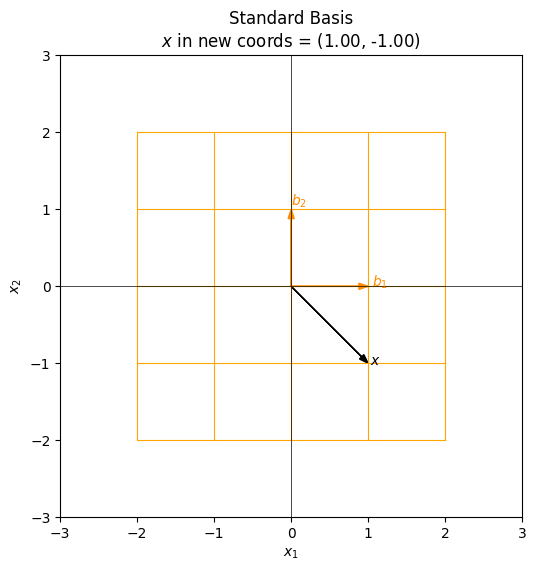

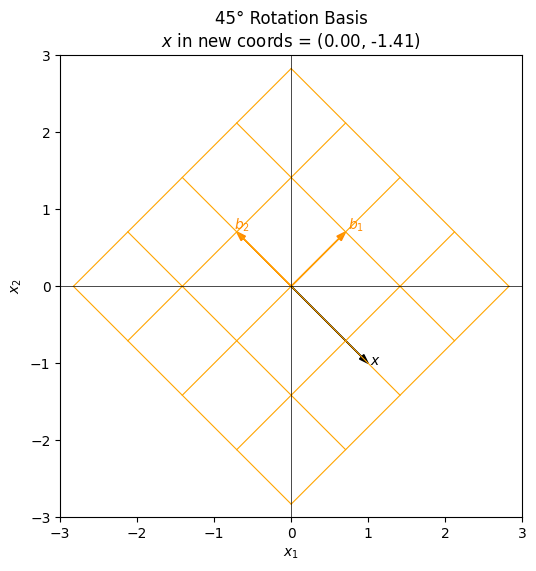

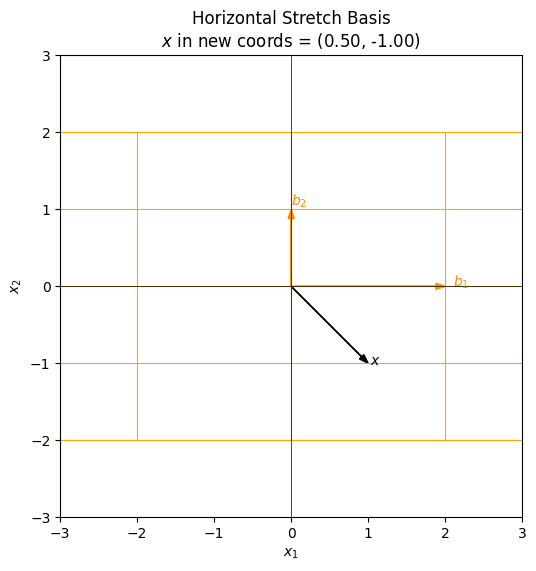

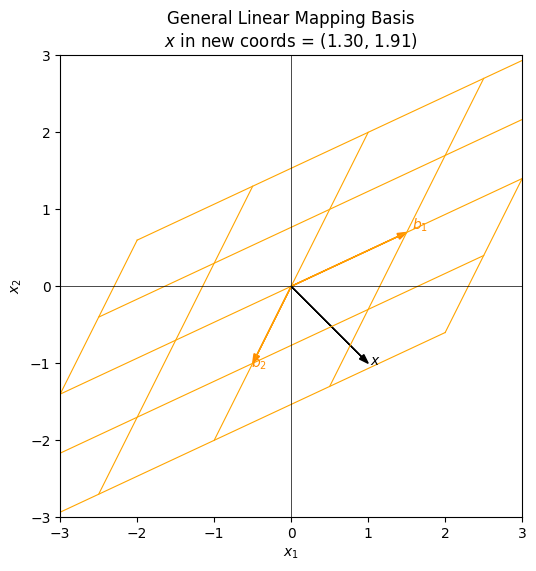

In [5]:
def get_coords_in_new_basis(T, x_std):
    """
    Compute the coordinates of x_std in the new basis defined by T.
    
    Parameters:
        T : numpy.ndarray, shape (2, 2)
            Transformation matrix whose columns form the new basis.
        x_std : numpy.ndarray, shape (2,)
            The vector in standard coordinates.
    
    Returns:
        numpy.ndarray, shape (2,): Coordinates of x_std in the new basis.
    """
    T_inv = np.linalg.inv(T)
    return T_inv @ x_std

def plot_basis_and_vector(T, x_std, title="", grid_range=range(-2, 3)):
    """
    Plot the skewed grid defined by the new basis T, the basis vectors,
    the vector x_std (in standard coordinates), and its decomposition
    in terms of the new basis.
    
    Parameters:
        T : numpy.ndarray, shape (2, 2)
            Transformation matrix whose columns define the new basis.
        x_std : numpy.ndarray, shape (2,)
            The vector in standard coordinates.
        title : str
            Plot title.
        grid_range : range or list of integers
            Lattice indices for drawing grid lines.
    """
    fig, ax = plt.subplots(figsize=(6, 6))
    
    # Plot the skewed grid lines
    for i in grid_range:
        points = []
        for j in grid_range:
            pt_std = T @ np.array([i, j])  # Transform new basis grid point to standard coordinates
            points.append(pt_std)
        points = np.array(points).T
        ax.plot(points[0], points[1], color='orange', linewidth=0.8)
        
    for j in grid_range:
        points = []
        for i in grid_range:
            pt_std = T @ np.array([i, j])
            points.append(pt_std)
        points = np.array(points).T
        ax.plot(points[0], points[1], color='orange', linewidth=0.8)
    
    # Plot the basis vectors (columns of T)
    b1 = T[:, 0]
    b2 = T[:, 1]
    ax.arrow(0, 0, b1[0], b1[1], head_width=0.08, length_includes_head=True,
             fc='darkorange', ec='darkorange')
    ax.text(b1[0]*1.05, b1[1]*1.05, '$b_1$', color='darkorange')
    
    ax.arrow(0, 0, b2[0], b2[1], head_width=0.08, length_includes_head=True,
             fc='darkorange', ec='darkorange')
    ax.text(b2[0]*1.05, b2[1]*1.05, '$b_2$', color='darkorange')
    
    # Plot the vector x_std in standard coordinates
    ax.arrow(0, 0, x_std[0], x_std[1], head_width=0.08, length_includes_head=True,
             fc='black', ec='black')
    ax.text(x_std[0]*1.02, x_std[1]*1.02, '$x$', color='black')
    
    # Decompose x_std in the new basis T
    x_new = get_coords_in_new_basis(T, x_std)
    alpha, beta = x_new[0], x_new[1]
    
    # Formatting the plot
    ax.axhline(0, color='black', linewidth=0.5)
    ax.axvline(0, color='black', linewidth=0.5)
    ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(-3, 3)
    ax.set_ylim(-3, 3)
    ax.set_xlabel('$x_1$')
    ax.set_ylabel('$x_2$')
    ax.set_title(title + f"\n$x$ in new coords = ({alpha:.2f}, {beta:.2f})")
    
    plt.show()

def show_vector_in_different_bases(x_std):
    """
    Display the vector x_std in the standard basis and in three new bases.
    
    The new bases are defined by transformation matrices obtained from
    get_transformation_matrices() (assumed to be defined elsewhere). This function:
      1. Plots x_std in the standard basis.
      2. Plots x_std in the basis of a 45° rotation.
      3. Plots x_std in the basis of a horizontal stretch.
      4. Plots x_std in the basis of a general linear mapping.
    """
    # Standard basis (identity matrix)
    I = np.eye(2)
    plot_basis_and_vector(I, x_std, title="Standard Basis")
    
    # Obtain the transformation matrices (defined in Part A)
    R45, S_horiz, A_gen = get_transformation_matrices()
    
    plot_basis_and_vector(R45, x_std, title="45° Rotation Basis")
    plot_basis_and_vector(S_horiz, x_std, title="Horizontal Stretch Basis")
    plot_basis_and_vector(A_gen, x_std, title="General Linear Mapping Basis")

# Example usage:
x_std = np.array([1, -1])  # The vector in standard coordinates
show_vector_in_different_bases(x_std)


In [6]:
def convert_std_to_new(T, x_std):
    """
    Convert a vector from the Standard Basis to the New Basis defined by T.

    The new basis is given by the columns of T. The conversion is:
        x_new = T⁻¹ * x_std

    Parameters:
        T : numpy.ndarray of shape (2, 2)
            Transformation matrix whose columns are the new basis vectors.
        x_std : numpy.ndarray of shape (2,)
            The vector in the standard basis.

    Returns:
        x_new : numpy.ndarray of shape (2,)
            The coordinates of the vector in the new basis.
    """
    print("=== Converting from Standard Basis to New Basis ===")
    print("Transformation matrix (T):")
    print(T)
    print("\nGiven vector in Standard Basis (x_std):")
    print(x_std)
    
    # Compute the new basis coordinates.
    x_new = np.linalg.inv(T) @ x_std
    print("\nComputed new basis coordinates (x_new = T⁻¹ * x_std):")
    print(x_new)
    
    return x_new

def convert_new_to_std(T, x_new):
    """
    Convert a vector from the New Basis back to the Standard Basis.

    The conversion is performed as:
        x_std = T * x_new

    Parameters:
        T : numpy.ndarray of shape (2, 2)
            Transformation matrix whose columns are the new basis vectors.
        x_new : numpy.ndarray of shape (2,)
            The vector in the new basis.

    Returns:
        x_std : numpy.ndarray of shape (2,)
            The coordinates of the vector in the standard basis.
    """
    print("\nGiven coordinates in the New Basis (x_new):")
    print(x_new)
    
    # Compute the standard basis coordinates.
    x_std = T @ x_new
    print("\nComputed Standard Basis coordinates (x_std = T * x_new):")
    print(x_std)
    print("====================================================\n")
    
    return x_std

def main():
    """
    Demonstrate conversion between coordinate representations using
    transformation matrices obtained from get_transformation_matrices().
    
    For each transformation matrix:
      1. Convert a sample vector x_std from the standard basis to the new basis.
      2. Convert the new basis coordinates back to the standard basis.
    """
    R45, S_horiz, A_gen = get_transformation_matrices()
    
    # Sample vector in the Standard Basis.
    x_std = np.array([1, 2])
    
    print(">> Using 45° Rotation Basis:")
    x_new_R45 = convert_std_to_new(R45, x_std)
    _ = convert_new_to_std(R45, x_new_R45)
    
    print(">> Using Horizontal Stretch Basis:")
    x_new_S_horiz = convert_std_to_new(S_horiz, x_std)
    _ = convert_new_to_std(S_horiz, x_new_S_horiz)
    
    print(">> Using General Linear Mapping Basis:")
    x_new_A_gen = convert_std_to_new(A_gen, x_std)
    _ = convert_new_to_std(A_gen, x_new_A_gen)

# To run the example conversions, call main() manually.
main()

>> Using 45° Rotation Basis:
=== Converting from Standard Basis to New Basis ===
Transformation matrix (T):
[[ 0.70710678 -0.70710678]
 [ 0.70710678  0.70710678]]

Given vector in Standard Basis (x_std):
[1 2]

Computed new basis coordinates (x_new = T⁻¹ * x_std):
[2.12132034 0.70710678]

Given coordinates in the New Basis (x_new):
[2.12132034 0.70710678]

Computed Standard Basis coordinates (x_std = T * x_new):
[1. 2.]

>> Using Horizontal Stretch Basis:
=== Converting from Standard Basis to New Basis ===
Transformation matrix (T):
[[2 0]
 [0 1]]

Given vector in Standard Basis (x_std):
[1 2]

Computed new basis coordinates (x_new = T⁻¹ * x_std):
[0.5 2. ]

Given coordinates in the New Basis (x_new):
[0.5 2. ]

Computed Standard Basis coordinates (x_std = T * x_new):
[1. 2.]

>> Using General Linear Mapping Basis:
=== Converting from Standard Basis to New Basis ===
Transformation matrix (T):
[[ 1.5 -0.5]
 [ 0.7 -1. ]]

Given vector in Standard Basis (x_std):
[1 2]

Computed new basis 

## third part

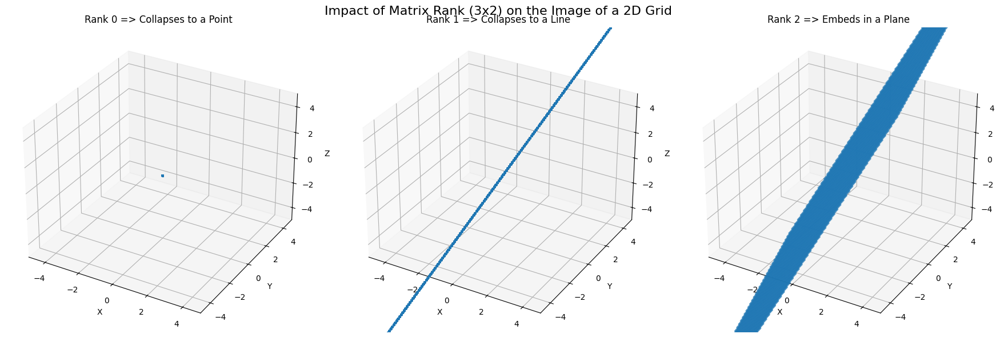

In [59]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# --------------------------------------------------------
# 1) Helper function: Generate a grid of points in R^2
# --------------------------------------------------------
def generate_2d_grid(num_points=5, x_range=(-2, 2), y_range=(-2, 2)):
    """
    Generates a grid of points in R^2, with shape (2, num_points^2).
    For example, if num_points=5, we'll have 25 points on a 5x5 grid.
    
    Parameters
    ----------
    num_points : int
        Number of points along each dimension in the 2D grid.
    x_range : tuple of floats
        Min and max for x-coordinates.
    y_range : tuple of floats
        Min and max for y-coordinates.
    
    Returns
    -------
    points_2d : numpy.ndarray of shape (2, num_points^2)
        The generated 2D grid points, each column is [x; y].
    """
    xs = np.linspace(x_range[0], x_range[1], num_points)
    ys = np.linspace(y_range[0], y_range[1], num_points)
    
    # Create a meshgrid and then flatten
    X, Y = np.meshgrid(xs, ys)
    X_flat = X.flatten()  # shape (num_points^2,)
    Y_flat = Y.flatten()  # shape (num_points^2,)
    
    # Stack into shape (2, N)
    points_2d = np.vstack((X_flat, Y_flat))
    return points_2d

# --------------------------------------------------------
# 2) Transformation function: M x 2D-points -> 3D points
# --------------------------------------------------------
def transform_points(M, points_2d):
    """
    Multiplies each 2D point by the 3x2 matrix M to get a set of 3D points.
    
    Parameters
    ----------
    M : numpy.ndarray of shape (3, 2)
        The transformation matrix.
    points_2d : numpy.ndarray of shape (2, N)
        The 2D points to be transformed.
        
    Returns
    -------
    points_3d : numpy.ndarray of shape (3, N)
        The resulting 3D points.
    """
    # M has shape (3, 2), points_2d has shape (2, N) -> product shape (3, N)
    return M @ points_2d

# --------------------------------------------------------
# 3) Plotting function: Plot 3D points
# --------------------------------------------------------
def plot_3d_points(ax, points_3d, title="3D Plot"):
    """
    Plots the given 3D points on the provided Axes3D object.
    
    Parameters
    ----------
    ax : Axes3D
        A 3D axis from matplotlib.
    points_3d : numpy.ndarray of shape (3, N)
        The 3D points to plot (scatter).
    title : str
        Title for the 3D plot.
    """
    ax.scatter(points_3d[0, :], points_3d[1, :], points_3d[2, :], s=5, alpha=0.6)
    ax.set_title(title)
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    # For clarity:
    ax.set_xlim(-5, 5)
    ax.set_ylim(-5, 5)
    ax.set_zlim(-5, 5)

# --------------------------------------------------------
# 4) Define Matrices of Different Ranks (3x2)
# --------------------------------------------------------
def get_rank_0_matrix():
    """
    Returns a 3x2 matrix with rank 0 (the zero matrix).
    This collapses every 2D point to the origin (0,0,0).
    """
    return np.zeros((3, 2))

def get_rank_1_matrix():
    """
    Returns a 3x2 matrix with rank 1.
    For instance, one column is a multiple of the other.
    E.g. columns = [1,2,3] and [2,4,6], which is 2 * [1,2,3].
    """
    col1 = np.array([1, 2, 3])
    col2 = 2 * col1
    M_rank1 = np.column_stack((col1, col2))  # shape (3, 2)
    return M_rank1

def get_rank_2_matrix():
    """
    Returns a 3x2 matrix with rank 2, i.e. two linearly independent columns.
    Example: columns = [1,3,5] and [2,4,7].
    We can verify these are linearly independent.
    """
    col1 = np.array([1, 3, 5])
    col2 = np.array([2, 4, 7])
    # Check independence quickly: if col1 is not a scalar multiple of col2 => rank = 2
    M_rank2 = np.column_stack((col1, col2))  # shape (3, 2)
    return M_rank2

# --------------------------------------------------------
# 5) Demo / Exercise Pipeline
# --------------------------------------------------------
def exercise_rank_demo():
    """
    Demonstrates how 2D -> 3D multiplication changes
    based on rank of the 3x2 matrix.
    """
    # Generate a set of 2D points (for example, a 5x5 grid in [-2,2] x [-2,2])
    points_2d = generate_2d_grid(num_points=100, x_range=(-2, 2), y_range=(-2, 2))
    
    # Grab the 3 matrices
    M0 = get_rank_0_matrix()  # rank 0
    M1 = get_rank_1_matrix()  # rank 1
    M2 = get_rank_2_matrix()  # rank 2
    
    # Transform the grid by each matrix
    points_3d_0 = transform_points(M0, points_2d)
    points_3d_1 = transform_points(M1, points_2d)
    points_3d_2 = transform_points(M2, points_2d)
    
    # Create a single figure with 3 subplots (all 3D).
    fig = plt.figure(figsize=(18, 6))
    
    # Rank 0: all points mapped to (0,0,0)
    ax0 = fig.add_subplot(1, 3, 1, projection='3d')
    plot_3d_points(ax0, points_3d_0, title="Rank 0 => Collapses to a Point")
    
    # Rank 1: all points mapped to a line
    ax1 = fig.add_subplot(1, 3, 2, projection='3d')
    plot_3d_points(ax1, points_3d_1, title="Rank 1 => Collapses to a Line")
    
    # Rank 2: all points mapped to a plane
    ax2 = fig.add_subplot(1, 3, 3, projection='3d')
    plot_3d_points(ax2, points_3d_2, title="Rank 2 => Embeds in a Plane")
    
    plt.suptitle("Impact of Matrix Rank (3x2) on the Image of a 2D Grid", fontsize=16)
    plt.tight_layout()
    plt.show()

# --------------------------------------------------------
# 6) Usage
# --------------------------------------------------------
def main():
    exercise_rank_demo()

if __name__ == "__main__":
    main()


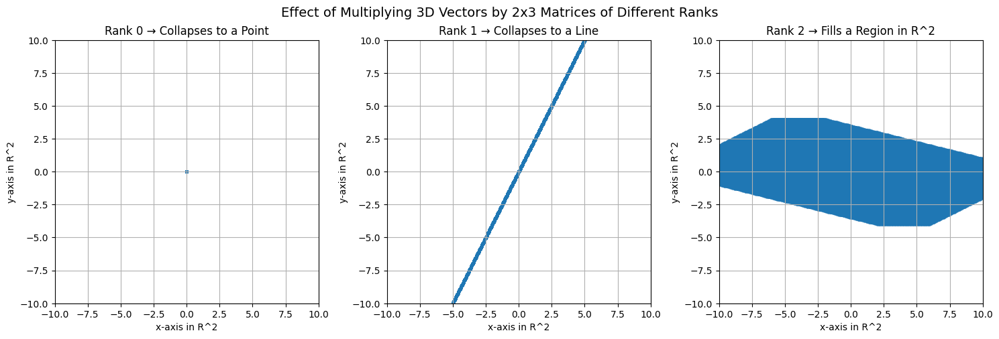

In [68]:
import numpy as np
import matplotlib.pyplot as plt

# ---------------------------------------------------------------------
# 1) Define 2x3 matrices of different ranks
# ---------------------------------------------------------------------
def get_rank_0_matrix_2x3():
    """
    Returns a 2x3 zero matrix (rank 0).
    Everything in R^3 maps to (0,0) in R^2.
    """
    return np.zeros((2, 3))

def get_rank_1_matrix_2x3():
    """
    Returns a 2x3 matrix with rank 1.
    We can achieve this by making the two rows multiples of each other,
    or by making columns all dependent.
    Example:
       row1 = [1, 2, 3]
       row2 = 2 * row1 -> rank = 1
    """
    row1 = np.array([1, 2, 3])
    row2 = 2 * row1
    # Stack into shape (2,3)
    M = np.vstack((row1, row2))
    return M

def get_rank_2_matrix_2x3():
    """
    Returns a 2x3 matrix with rank 2 (i.e., two linearly independent rows).
    Example:
      row1 = [1, 0, 2]
      row2 = [0, 1, 1]
    These two rows are not multiples of each other => rank = 2.
    """
    row1 = np.array([1, -4, 2])
    row2 = np.array([0, 1, 1])
    # row1 = np.array([2, 3, 1])
    # row2 = np.array([1, -1, 4])         
    M = np.vstack((row1, row2))
    return M

# ---------------------------------------------------------------------
# 2) Generate a discrete 3D domain
# ---------------------------------------------------------------------
def generate_3d_domain(n=5, range_3d=(-2, 2)):
    """
    Generates a 3D grid of points in [range_3d[0], range_3d[1]]^3, with n steps each dimension.
    Returns an array of shape (3, n^3): each column is (x,y,z).
    """
    xs = np.linspace(range_3d[0], range_3d[1], n)
    ys = np.linspace(range_3d[0], range_3d[1], n)
    zs = np.linspace(range_3d[0], range_3d[1], n)
    
    X, Y, Z = np.meshgrid(xs, ys, zs, indexing='ij')
    # Flatten each to shape (n^3,)
    Xf = X.flatten()
    Yf = Y.flatten()
    Zf = Z.flatten()
    points_3d = np.vstack((Xf, Yf, Zf))  # shape (3, n^3)
    return points_3d

# ---------------------------------------------------------------------
# 3) Transform 3D points into 2D
# ---------------------------------------------------------------------
def transform_3d_to_2d(M, points_3d):
    """
    Multiply M (2x3) by each column of points_3d (3xN) => results in 2xN.
    """
    return M @ points_3d  # shape = (2, N)

# ---------------------------------------------------------------------
# 4) Plotting each rank scenario
# ---------------------------------------------------------------------
def visualize_2D_image(points_2d, ax, title=""):
    """
    Plots the 2D points (shape (2, N)) in a scatter on the provided axis.
    """
    ax.scatter(points_2d[0, :], points_2d[1, :], s=5, alpha=0.5)
    ax.set_aspect('equal', 'box')
    ax.set_title(title)
    ax.set_xlabel("x-axis in R^2")
    ax.set_ylabel("y-axis in R^2")
    # Adjust the limits so we can see everything
    ax.set_xlim(-10, 10)
    ax.set_ylim(-10, 10)
    ax.grid(True)

def demo_2x3_ranks():
    """
    Demonstrates how a 3D domain collapses to different shapes in R^2,
    depending on the matrix's rank (0, 1, or 2).
    """
    # 1) Define the three matrices
    M0 = get_rank_0_matrix_2x3()  # rank=0
    M1 = get_rank_1_matrix_2x3()  # rank=1
    M2 = get_rank_2_matrix_2x3()  # rank=2
    
    # 2) Generate a discrete 3D domain
    domain_3d = generate_3d_domain(n=100, range_3d=(-2,2,))
    
    # 3) Transform all points
    image_2d_0 = transform_3d_to_2d(M0, domain_3d)
    image_2d_1 = transform_3d_to_2d(M1, domain_3d)
    image_2d_2 = transform_3d_to_2d(M2, domain_3d)
    
    # 4) Plot results side by side
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    visualize_2D_image(image_2d_0, axes[0], title="Rank 0 → Collapses to a Point")
    visualize_2D_image(image_2d_1, axes[1], title="Rank 1 → Collapses to a Line")
    visualize_2D_image(image_2d_2, axes[2], title="Rank 2 → Fills a Region in R^2")
    
    plt.suptitle("Effect of Multiplying 3D Vectors by 2x3 Matrices of Different Ranks", fontsize=14)
    plt.tight_layout()
    plt.show()

# ---------------------------------------------------------------------
# 5) Main
# ---------------------------------------------------------------------
def main():
    demo_2x3_ranks()

if __name__ == "__main__":
    main()


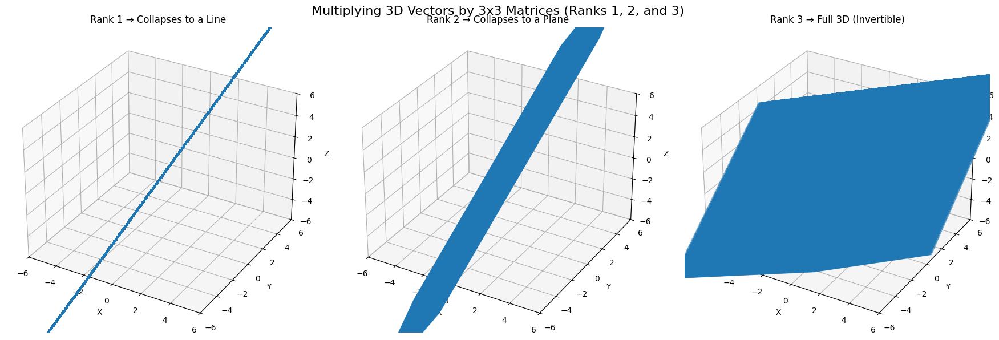

In [75]:
 import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ----------------------------------------------------
# 1) Generate a discrete 3D domain
# ----------------------------------------------------
def generate_3d_domain(n=5, range_3d=(-2, 2)):
    """
    Creates a discrete grid of points in the 3D cube [range_3d[0], range_3d[1]]^3,
    returning an array of shape (3, n^3) with each column = (x, y, z).
    """
    xs = np.linspace(range_3d[0], range_3d[1], n)
    ys = np.linspace(range_3d[0], range_3d[1], n)
    zs = np.linspace(range_3d[0], range_3d[1], n)
    
    X, Y, Z = np.meshgrid(xs, ys, zs, indexing='ij')
    Xf = X.flatten()
    Yf = Y.flatten()
    Zf = Z.flatten()
    points_3d = np.vstack((Xf, Yf, Zf))  # shape: (3, n^3)
    return points_3d

# ----------------------------------------------------
# 2) Multiply 3D points by a 3x3 matrix
# ----------------------------------------------------
def transform_3d_points(M, points_3d):
    """
    Multiply M (3x3) by each column of points_3d (3, N).
    Result has shape (3, N).
    """
    return M @ points_3d

# ----------------------------------------------------
# 3) Plot 3D points
# ----------------------------------------------------
def plot_3d_scatter(points_3d, ax, title=""):
    """
    Scatter-plot the columns of points_3d (shape (3, N)) in 3D.
    """
    ax.scatter(points_3d[0, :], points_3d[1, :], points_3d[2, :],
               s=5, alpha=0.5)
    ax.set_title(title)
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.set_xlim(-6, 6)
    ax.set_ylim(-6, 6)
    ax.set_zlim(-6, 6)

# ----------------------------------------------------
# 4) Matrices with rank = 1, 2, 3
# ----------------------------------------------------
def get_rank_1_matrix_3x3():
    """
    Returns a 3x3 matrix with rank 1.
    We'll make all columns multiples of a single vector.
    Example: col1 = [1,2,3], col2 = 2*col1, col3 = -1*col1
    """
    col1 = np.array([1, 2, 3])
    col2 = 2 * col1
    col3 = -1 * col1
    M = np.column_stack((col1, col2, col3))  # shape (3,3)
    # This ensures that the three columns are linearly dependent with only 1 dimension of span.
    return M

def get_rank_2_matrix_3x3():
    """
    Returns a 3x3 matrix with rank 2.
    We'll ensure exactly two columns are independent, 
    and the third is a linear combination of the first two.
    """
    # col1, col2 are independent; col3 = col1 + 2*col2 for instance.
    col1 = np.array([1, 0, 2])
    col2 = np.array([0, 1, 1])
    col3 = col1 + 2*col2  # linear combo => rank 2
    M = np.column_stack((col1, col2, col3))  # shape (3,3)
    return M

def get_rank_3_matrix_3x3():
    """
    Returns a 3x3 invertible matrix (rank = 3).
    We'll choose something simple. For instance, 
    a diagonal with non-zero entries or a small random matrix with nonzero determinant.
    """
    # A simple invertible example:
    M = np.array([
        [2, 1, 0],
        [0, 1, 2],
        [1, 0, 2]
    ], dtype=float)
    # This should be invertible as long as the determinant is nonzero.
    # Let's check quickly:
    det = np.linalg.det(M)
    if abs(det) < 1e-9:
        raise ValueError("Chosen matrix is not invertible, change the entries!")
    return M

# ----------------------------------------------------
# 5) Exercise / Demo: R^3 -> R^3 for ranks 1,2,3
# ----------------------------------------------------
def demo_3x3_ranks():
    """
    1) Generate a 3D domain (like a small cube).
    2) For each rank (1,2,3) matrix, multiply the points to get output in R^3.
    3) Plot the results in 3 side-by-side subplots.
    """
    # 1) Domain
    domain_3d = generate_3d_domain(n=100, range_3d=(-2.5,2.5))
    
    # 2) Define matrices
    M1 = get_rank_1_matrix_3x3()  # rank=1
    M2 = get_rank_2_matrix_3x3()  # rank=2
    M3 = get_rank_3_matrix_3x3()  # rank=3
    
    # 3) Transform
    image1 = transform_3d_points(M1, domain_3d)  # shape (3, n^3)
    image2 = transform_3d_points(M2, domain_3d)
    image3 = transform_3d_points(M3, domain_3d)
    
    # 4) Plot
    fig = plt.figure(figsize=(18, 6))
    
    ax1 = fig.add_subplot(1, 3, 1, projection='3d')
    plot_3d_scatter(image1, ax1, title="Rank 1 → Collapses to a Line")
    
    ax2 = fig.add_subplot(1, 3, 2, projection='3d')
    plot_3d_scatter(image2, ax2, title="Rank 2 → Collapses to a Plane")
    
    ax3 = fig.add_subplot(1, 3, 3, projection='3d')
    plot_3d_scatter(image3, ax3, title="Rank 3 → Full 3D (Invertible)")
    
    plt.suptitle("Multiplying 3D Vectors by 3x3 Matrices (Ranks 1, 2, and 3)", fontsize=16)
    plt.tight_layout()
    plt.show()

# ----------------------------------------------------
# 6) Main
# ----------------------------------------------------
def main():
    demo_3x3_ranks()

if __name__ == "__main__":
    main()


## Part C with matplotlib

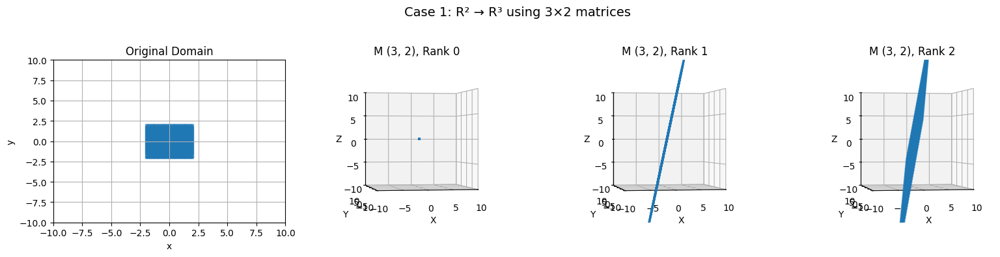

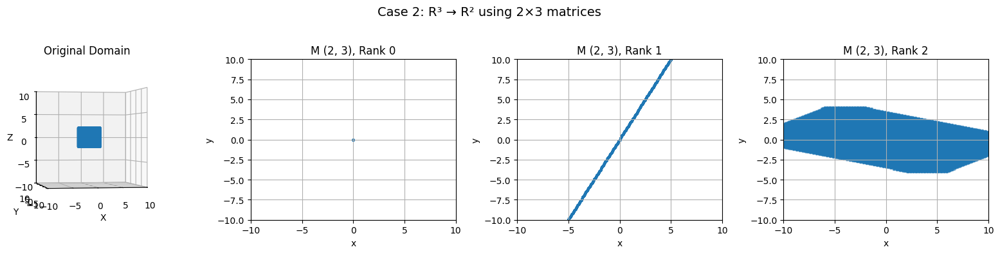

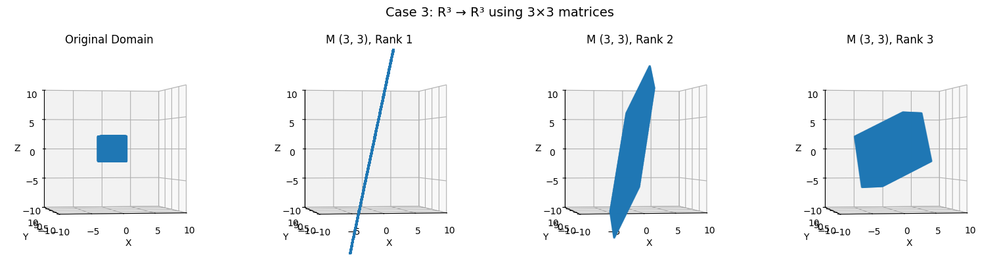

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Required for 3D plotting

# ====================================================
# 1. Domain Generation (2D or 3D)
# ====================================================
def generate_grid_points(dim, n, value_range):
    """
    Generate a grid of points in R^dim.
    
    Parameters:
        dim : int
            Dimension of the domain (2 or 3).
        n : int
            Number of points along each axis.
        value_range : tuple of floats
            (min, max) for each coordinate.
            
    Returns:
        points : numpy.ndarray of shape (dim, n^dim)
            Each column is a point in R^dim.
    """
    if dim == 2:
        xs = np.linspace(value_range[0], value_range[1], n)
        ys = np.linspace(value_range[0], value_range[1], n)
        X, Y = np.meshgrid(xs, ys)
        points = np.vstack((X.flatten(), Y.flatten()))
    elif dim == 3:
        xs = np.linspace(value_range[0], value_range[1], n)
        ys = np.linspace(value_range[0], value_range[1], n)
        zs = np.linspace(value_range[0], value_range[1], n)
        X, Y, Z = np.meshgrid(xs, ys, zs, indexing='ij')
        points = np.vstack((X.flatten(), Y.flatten(), Z.flatten()))
    else:
        raise ValueError("Dimension must be 2 or 3.")
    return points

# ====================================================
# 2. Custom Plotting Function with Axis Limits
# ====================================================
def plot_points_custom(ax, points, title="", plot_lim=(-10, 10)):
    """
    Plot points on the provided axis with custom axis limits.
    
    Parameters:
        ax : matplotlib axis (2D or 3D)
        points : numpy.ndarray of shape (dim, N)
            Points to plot.
        title : str
            Plot title.
        plot_lim : tuple of floats
            Axis limits for each axis.
    """
    dim = points.shape[0]
    if dim == 2:
        ax.scatter(points[0, :], points[1, :], s=2.5, alpha=0.5)
        ax.set_xlim(plot_lim)
        ax.set_ylim(plot_lim)
        ax.set_xlabel("x")
        ax.set_ylabel("y")
    elif dim == 3:
        ax.set_box_aspect((1, 1, 1))
        ax.scatter(points[0, :], points[1, :], points[2, :], s=2.5, alpha=0.5)
        ax.set_xlim(plot_lim)
        ax.set_ylim(plot_lim)
        ax.set_zlim(plot_lim)
        ax.set_xlabel("X")
        ax.set_ylabel("Y")
        ax.set_zlabel("Z")
        ax.view_init(elev=0, azim=-100)

    else:
        raise ValueError("Plotting for dimension {} not supported.".format(dim))
    ax.set_title(title)
    ax.grid(True)

# ====================================================
# 3. Matrix Construction Functions
# ====================================================
# --- Case 1: 3x2 matrices (map R^2 -> R^3)
def get_rank_0_matrix_3x2():
    """Return a 3x2 zero matrix (rank 0)."""
    return np.zeros((3, 2))

def get_rank_1_matrix_3x2():
    """Return a 3x2 matrix with rank 1 (dependent columns)."""
    col1 = np.array([1, 2, 3])
    col2 = 2 * col1
    return np.column_stack((col1, col2))

def get_rank_2_matrix_3x2():
    """Return a 3x2 matrix with rank 2 (independent columns)."""
    col1 = np.array([1, 3, 5])
    col2 = np.array([2, 4, 7])
    return np.column_stack((col1, col2))

# --- Case 2: 2x3 matrices (map R^3 -> R^2)
def get_rank_0_matrix_2x3():
    """Return a 2x3 zero matrix (rank 0)."""
    return np.zeros((2, 3))

def get_rank_1_matrix_2x3():
    """Return a 2x3 matrix with rank 1 (dependent rows)."""
    row1 = np.array([1, 2, 3])
    row2 = 2 * row1
    return np.vstack((row1, row2))

def get_rank_2_matrix_2x3():
    """Return a 2x3 matrix with rank 2 (independent rows)."""
    row1 = np.array([1, -4, 2])
    row2 = np.array([0, 1, 1])
    return np.vstack((row1, row2))

# --- Case 3: 3x3 matrices (map R^3 -> R^3)
def get_rank_1_matrix_3x3():
    """Return a 3x3 matrix with rank 1 (all columns multiples)."""
    col1 = np.array([1, 2, 3])
    col2 = 2 * col1
    col3 = -1 * col1
    return np.column_stack((col1, col2, col3))

def get_rank_2_matrix_3x3():
    """Return a 3x3 matrix with rank 2 (two independent columns)."""
    col1 = np.array([1, 0, 2])
    col2 = np.array([0, 1, 1])
    col3 = col1 + 2 * col2
    return np.column_stack((col1, col2, col3))

def get_rank_3_matrix_3x3():
    """Return a 3x3 full-rank (invertible) matrix (rank 3)."""
    M = np.array([[2, 1, 0],
                  [0, 1, 2],
                  [1, 0, 2]], dtype=float)
    if abs(np.linalg.det(M)) < 1e-9:
        raise ValueError("Matrix is not invertible; adjust entries.")
    return M

# ====================================================
# 4. Transformation Pipeline for One Case
# ====================================================
def run_case(matrices, n, grid_range, plot_lim=(-10, 10), case_title=""):
    """
    For a given list of matrices (with the same domain dimension),
    generate the original domain and then transform it with each matrix.
    Plot the original domain and each transformed set in one row of subplots.
    
    The first subplot shows the original domain; subsequent subplots show
    the image of the domain under each matrix.
    
    Parameters:
        matrices : list of numpy.ndarray
            List of transformation matrices.
        n : int
            Number of points along each axis in the grid.
        grid_range : tuple of floats
            Range (min, max) for generating the domain.
        plot_lim : tuple of floats, default (-10, 10)
            Axis limits for plotting.
        case_title : str
            Title for the row of plots.
            
    Returns:
        List of axes objects.
    """
    total_plots = 1 + len(matrices)
    fig = plt.figure(figsize=(4 * total_plots, 4))
    axes = []
    
    # Determine the domain dimension from the first matrix's columns.
    domain_dim = matrices[0].shape[1]
    # Create axis for original domain:
    if domain_dim == 3:
        ax0 = fig.add_subplot(1, total_plots, 1, projection='3d')
    else:
        ax0 = fig.add_subplot(1, total_plots, 1)
    axes.append(ax0)
    original_points = generate_grid_points(domain_dim, n, grid_range)
    plot_points_custom(ax0, original_points, title="Original Domain", plot_lim=plot_lim)
    
    # For each matrix, plot the transformed points.
    for idx, M in enumerate(matrices, start=2):
        codomain_dim = M.shape[0]
        if codomain_dim == 3:
            ax = fig.add_subplot(1, total_plots, idx, projection='3d')
        else:
            ax = fig.add_subplot(1, total_plots, idx)
        axes.append(ax)
        transformed_points = M @ original_points
        rank = np.linalg.matrix_rank(M)
        title = f"M {M.shape}, Rank {rank}"
        plot_points_custom(ax, transformed_points, title=title, plot_lim=plot_lim)
    
    fig.suptitle(case_title, fontsize=14)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    return axes

# ====================================================
# 5. Main: Run All Cases in a Unified Pipeline
# ====================================================
def main():
    # Input parameters
    n_points = 50        # Number of points along each axis in the grid
    grid_range = (-2, 2) # Domain range for each coordinate
    plot_lim = (-10, 10) # Axis limits for plotting
    
    # Define cases as tuples: (list_of_matrices, case_title)
    cases = [
        #Case 1: 3x2 matrices (map R^2 -> R^3)
        ([get_rank_0_matrix_3x2(), get_rank_1_matrix_3x2(), get_rank_2_matrix_3x2()],
         "Case 1: R² → R³ using 3×2 matrices"),
        # # Case 2: 2x3 matrices (map R^3 -> R²)
        ([get_rank_0_matrix_2x3(), get_rank_1_matrix_2x3(), get_rank_2_matrix_2x3()],
         "Case 2: R³ → R² using 2×3 matrices"),
        # Case 3: 3x3 matrices (map R^3 → R^3)
        ([get_rank_1_matrix_3x3(), get_rank_2_matrix_3x3(), get_rank_3_matrix_3x3()],
         "Case 3: R³ → R³ using 3×3 matrices")
    ]
    
    # Run each case: each case's plots are shown in one row.
    for matrices, case_title in cases:
        run_case(matrices, n_points, grid_range, plot_lim=plot_lim, case_title=case_title)

# Run the full pipeline
main()


## Part c with plotly

In [17]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# ====================================================
# 1. Domain Generation (2D or 3D)
# ====================================================
def generate_grid_points(dim, n, value_range):
    """
    Generate a grid of points in R^dim.
    
    Parameters:
        dim : int
            Dimension of the domain (2 or 3).
        n : int
            Number of points along each axis.
        value_range : tuple of floats
            (min, max) for each coordinate.
            
    Returns:
        points : numpy.ndarray of shape (dim, n^dim)
            Each column is a point in R^dim.
    """
    if dim == 2:
        xs = np.linspace(value_range[0], value_range[1], n)
        ys = np.linspace(value_range[0], value_range[1], n)
        X, Y = np.meshgrid(xs, ys)
        points = np.vstack((X.flatten(), Y.flatten()))
    elif dim == 3:
        xs = np.linspace(value_range[0], value_range[1], n)
        ys = np.linspace(value_range[0], value_range[1], n)
        zs = np.linspace(value_range[0], value_range[1], n)
        X, Y, Z = np.meshgrid(xs, ys, zs, indexing='ij')
        points = np.vstack((X.flatten(), Y.flatten(), Z.flatten()))
    else:
        raise ValueError("Dimension must be 2 or 3.")
    return points

# ====================================================
# 2. Plotly Version of Custom Plotting Function
# ====================================================
def run_case_plotly(matrices, n, grid_range, plot_lim=(-10, 10), case_title=""):
    """
    For a given list of matrices (all having the same domain dimension),
    generate the original domain and transform it with each matrix.
    Plot the original domain and each transformed set in one row of 3D subplots.
    
    If the domain (or codomain) is 2D, the points are embedded in 3D by setting z=0.
    
    Parameters:
        matrices : list of numpy.ndarray
            List of transformation matrices.
        n : int
            Number of points along each axis in the grid.
        grid_range : tuple of floats
            (min, max) for domain generation.
        plot_lim : tuple of floats, default (-10, 10)
            Axis limits for each axis in the plots.
        case_title : str
            Title for the row of plots.
    """
    total_plots = 1 + len(matrices)
    # Create a subplot figure with one row and total_plots columns (all as 3D scenes)
    fig = make_subplots(rows=1, cols=total_plots,
                        specs=[[{'type': 'scene'} for _ in range(total_plots)]],
                        subplot_titles=["Original Domain"] + 
                                       [f"M {M.shape}, Rank {np.linalg.matrix_rank(M)}" for M in matrices])
    
    # Domain dimension: determined by the first matrix's number of columns.
    domain_dim = matrices[0].shape[1]
    original_points = generate_grid_points(domain_dim, n, grid_range)
    # If the domain is 2D, lift to 3D by adding a row of zeros.
    if domain_dim == 2:
        zeros = np.zeros((1, original_points.shape[1]))
        original_points_3d = np.vstack((original_points, zeros))
    else:
        original_points_3d = original_points

    # Add original domain trace in the first subplot (col 1)
    trace0 = go.Scatter3d(
        x=original_points_3d[0, :],
        y=original_points_3d[1, :],
        z=original_points_3d[2, :],
        mode='markers',
        marker=dict(size=3, opacity=0.5)
    )
    fig.add_trace(trace0, row=1, col=1)
    
    # For each transformation matrix, compute and add a trace.
    for i, M in enumerate(matrices):
        transformed_points = M @ original_points
        codomain_dim = M.shape[0]
        if codomain_dim == 2:
            zeros = np.zeros((1, transformed_points.shape[1]))
            transformed_points_3d = np.vstack((transformed_points, zeros))
        else:
            transformed_points_3d = transformed_points
            
        trace = go.Scatter3d(
            x=transformed_points_3d[0, :],
            y=transformed_points_3d[1, :],
            z=transformed_points_3d[2, :],
            mode='markers',
            marker=dict(size=3, opacity=0.5)
        )
        # Subplots are 1-indexed; add trace to column i+2.
        fig.add_trace(trace, row=1, col=i+2)
    
    # Update each subplot's scene settings to enforce equal aspect ratio and custom axis limits.
    for i in range(total_plots):
        scene_id = f'scene{i+1}'
        fig.layout[scene_id].update(
            xaxis=dict(range=list(plot_lim), title="X"),
            yaxis=dict(range=list(plot_lim), title="Y"),
            zaxis=dict(range=list(plot_lim), title="Z"),
            aspectmode="cube"
        )
    
    fig.update_layout(title_text=case_title, showlegend=False)
    fig.show()

# ====================================================
# 3. Matrix Construction Functions
# ====================================================
# --- Case 1: 3x2 matrices (map R^2 -> R^3)
def get_rank_0_matrix_3x2():
    """Return a 3x2 zero matrix (rank 0)."""
    return np.zeros((3, 2))

def get_rank_1_matrix_3x2():
    """Return a 3x2 matrix with rank 1 (dependent columns)."""
    col1 = np.array([1, 2, 3])
    col2 = 2 * col1
    return np.column_stack((col1, col2))

def get_rank_2_matrix_3x2():
    """Return a 3x2 matrix with rank 2 (independent columns)."""
    col1 = np.array([1, 3, 5])
    col2 = np.array([2, 4, 7])
    return np.column_stack((col1, col2))

# --- Case 2: 2x3 matrices (map R^3 -> R^2)
def get_rank_0_matrix_2x3():
    """Return a 2x3 zero matrix (rank 0)."""
    return np.zeros((2, 3))

def get_rank_1_matrix_2x3():
    """Return a 2x3 matrix with rank 1 (dependent rows)."""
    row1 = np.array([1, 2, 3])
    row2 = 2 * row1
    return np.vstack((row1, row2))

def get_rank_2_matrix_2x3():
    """Return a 2x3 matrix with rank 2 (independent rows)."""
    row1 = np.array([1, -4, 2])
    row2 = np.array([0, 1, 1])
    return np.vstack((row1, row2))

# --- Case 3: 3x3 matrices (map R^3 -> R^3)
def get_rank_1_matrix_3x3():
    """Return a 3x3 matrix with rank 1 (all columns multiples)."""
    col1 = np.array([1, 2, 3])
    col2 = 2 * col1
    col3 = -1 * col1
    return np.column_stack((col1, col2, col3))

def get_rank_2_matrix_3x3():
    """Return a 3x3 matrix with rank 2 (two independent columns)."""
    col1 = np.array([1, 0, 2])
    col2 = np.array([0, 1, 1])
    col3 = col1 + 2 * col2
    return np.column_stack((col1, col2, col3))

def get_rank_3_matrix_3x3():
    """Return a 3x3 full-rank (invertible) matrix (rank 3)."""
    M = np.array([[2, 1, 0],
                  [0, 1, 2],
                  [1, 0, 2]], dtype=float)
    if abs(np.linalg.det(M)) < 1e-9:
        raise ValueError("Matrix is not invertible; adjust entries.")
    return M

# ====================================================
# 4. Main: Run All Cases in a Unified Pipeline
# ====================================================
def main():
    # Input parameters
    n_points = 50        # Number of points along each axis in the grid
    grid_range = (-2, 2) # Domain range for each coordinate
    plot_lim = (-10, 10) # Axis limits for plotting
    
    # Define cases as tuples: (list_of_matrices, case_title)
    cases = [
        # Case 1: 3x2 matrices (map R^2 -> R^3)
        ([get_rank_0_matrix_3x2(), get_rank_1_matrix_3x2(), get_rank_2_matrix_3x2()],
         "Case 1: R² → R³ using 3×2 matrices"),
        # Case 2: 2x3 matrices (map R^3 -> R²)
        ([get_rank_0_matrix_2x3(), get_rank_1_matrix_2x3(), get_rank_2_matrix_2x3()],
         "Case 2: R³ → R² using 2×3 matrices"),
        # Case 3: 3x3 matrices (map R^3 → R³)
        ([get_rank_1_matrix_3x3(), get_rank_2_matrix_3x3(), get_rank_3_matrix_3x3()],
         "Case 3: R³ → R³ using 3×3 matrices")
    ]
    
    # Run each case: each case's plots are shown in one row.
    for matrices, case_title in cases:
        run_case_plotly(matrices, n_points, grid_range, plot_lim=plot_lim, case_title=case_title)

# Run the full pipeline
main()
